# Plant Disease Classification Using CNN (Convolutional Neural Network)
### Dataset: [Plant Village Dataset](https://www.kaggle.com/datasets/abdallahalidev/plantvillage-dataset)

In [ ]:
!pip show tensorflow

Name: tensorflow
Version: 2.17.1
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: absl-py, astunparse, flatbuffers, gast, google-pasta, grpcio, h5py, keras, libclang, ml-dtypes, numpy, opt-einsum, packaging, protobuf, requests, setuptools, six, tensorboard, tensorflow-io-gcs-filesystem, termcolor, typing-extensions, wrapt
Required-by: dopamine_rl, tf_keras


In [ ]:
# Library umum
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import shutil
import random
import zipfile

# TensorFlow dan Keras
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing import image_dataset_from_directory
import cv2  # OpenCV untuk membaca gambar

# Untuk mengakses Google Drive
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
with zipfile.ZipFile('/content/drive/My Drive/Capstone_C242-PS328/Dataset/Dataset_Gabungan/Plant_leaf_diseases_dataset_with_augmentation.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/dataset')
print(os.listdir('/content/dataset'))

['Plant_leave_diseases_dataset_with_augmentation']


# Eksplorasi Dataset Gambar Plant Disease

In [ ]:
dataset_dir = '/content/dataset/Plant_leave_diseases_dataset_with_augmentation'

In [ ]:
# Cek jumlah gambar per kelas penyakit pada tanaman
# Daftar jumlah gambar per kelas
class_folders = os.listdir(dataset_dir)
class_counts = []
for class_name in class_folders:
    class_path = os.path.join(dataset_dir, class_name)
    if os.path.isdir(class_path):
        num_images = len(os.listdir(class_path))  # Menghitung jumlah gambar di dalam kelas
        class_counts.append((class_name, num_images))

# Menampilkan hasil
print("Class counts (Class Name, Number of Images):")
for class_name, num_images in class_counts:
    print(f"Class: {class_name}, Number of images: {num_images}")

Class counts (Class Name, Number of Images):
Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Number of images: 5357
Class: Tomato___Target_Spot, Number of images: 1404
Class: Orange___Haunglongbing_(Citrus_greening), Number of images: 5507
Class: Tomato___Late_blight, Number of images: 1909
Class: Background_without_leaves, Number of images: 1143
Class: Tomato___healthy, Number of images: 1591
Class: Apple___Apple_scab, Number of images: 1000
Class: Cherry___healthy, Number of images: 1000
Class: Tomato___Tomato_mosaic_virus, Number of images: 1000
Class: Soybean___healthy, Number of images: 5090
Class: Tomato___Spider_mites Two-spotted_spider_mite, Number of images: 1676
Class: Strawberry___Leaf_scorch, Number of images: 1109
Class: Pepper,_bell___healthy, Number of images: 1478
Class: Tomato___Bacterial_spot, Number of images: 2127
Class: Grape___Esca_(Black_Measles), Number of images: 1383
Class: Peach___healthy, Number of images: 1000
Class: Cherry___Powdery_mildew, Number of images

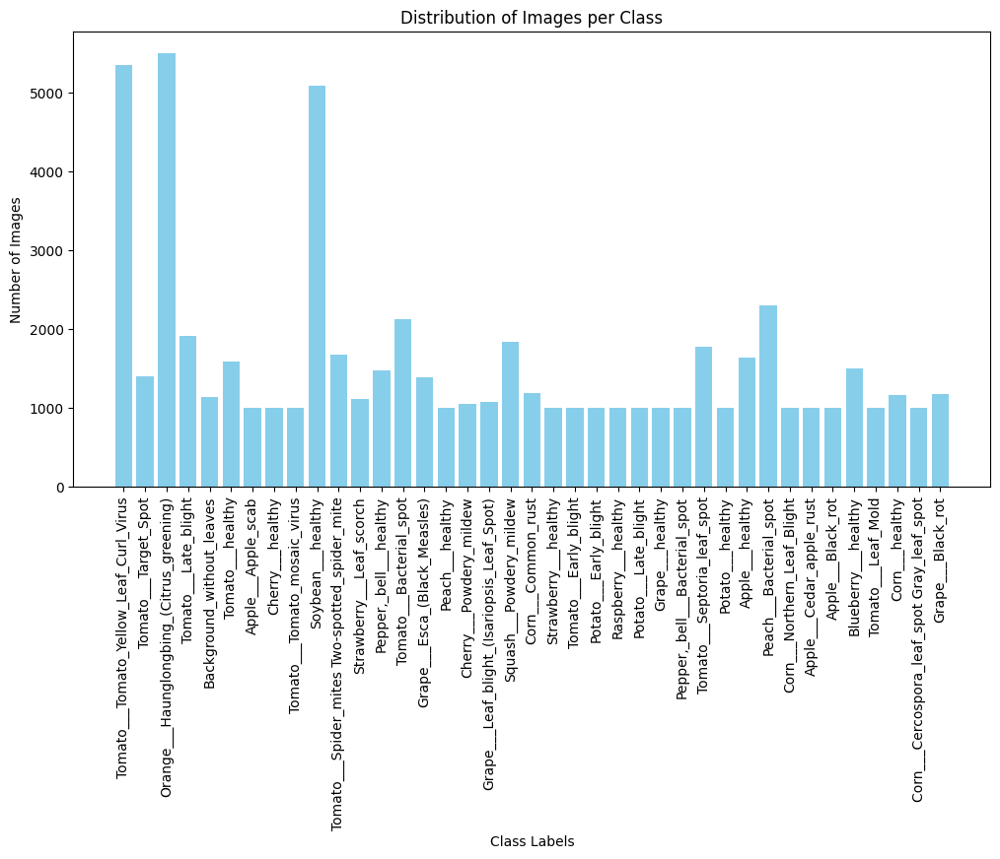

In [ ]:
# Memisahkan nama kelas dan jumlah gambar ke dua list terpisah
class_names = [item[0] for item in class_counts]
image_counts = [item[1] for item in class_counts]

# Membuat histogram distribusi jumlah gambar per kelas
plt.figure(figsize=(12, 6))
plt.bar(class_names, image_counts, color='skyblue')
plt.xlabel('Class Labels')
plt.ylabel('Number of Images')
plt.title('Distribution of Images per Class')
plt.xticks(rotation=90)
plt.show()

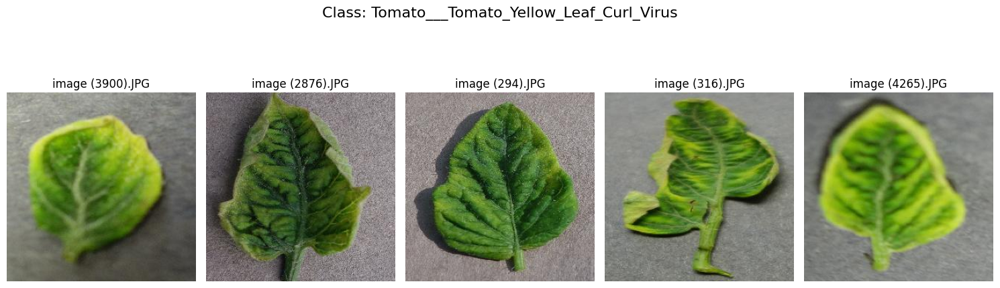

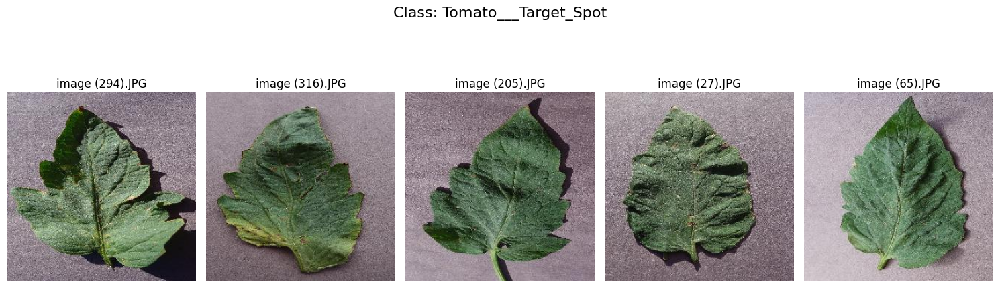

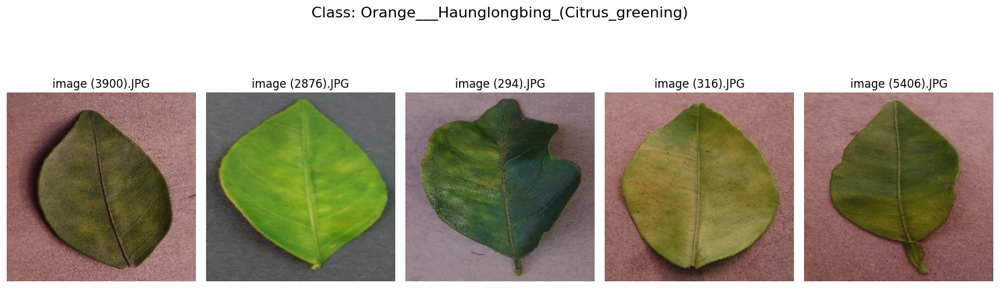

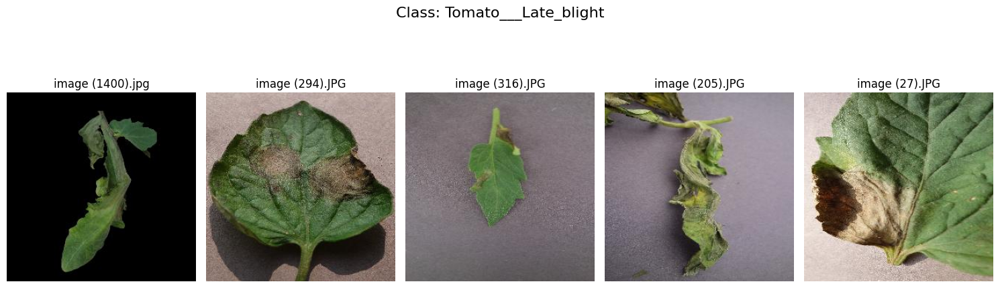

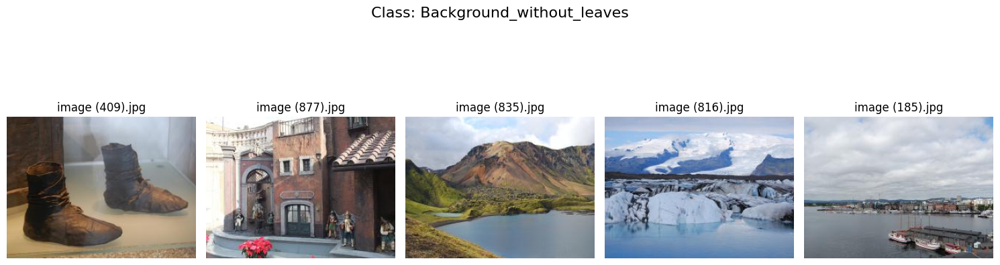

...

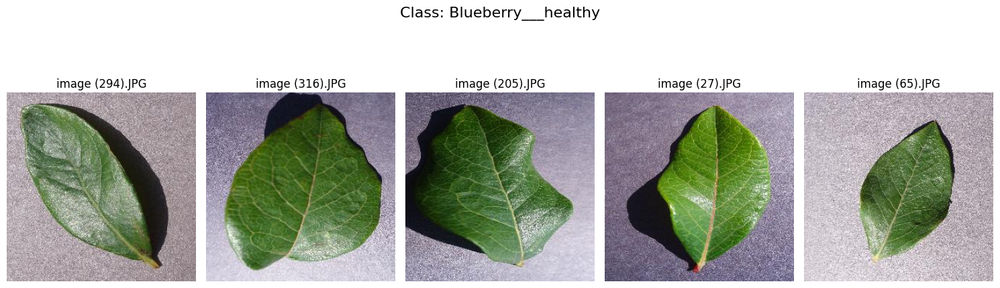

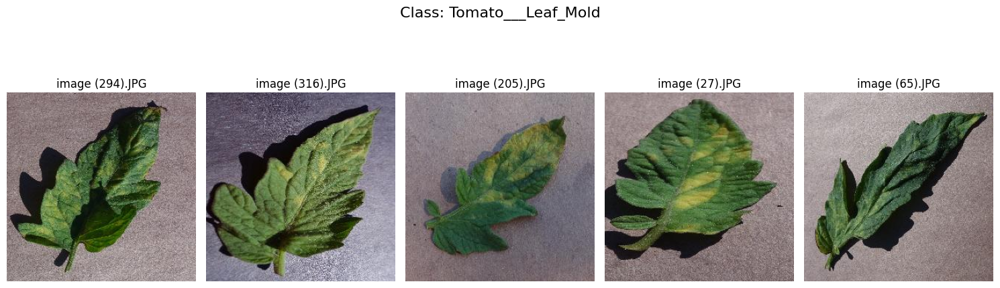

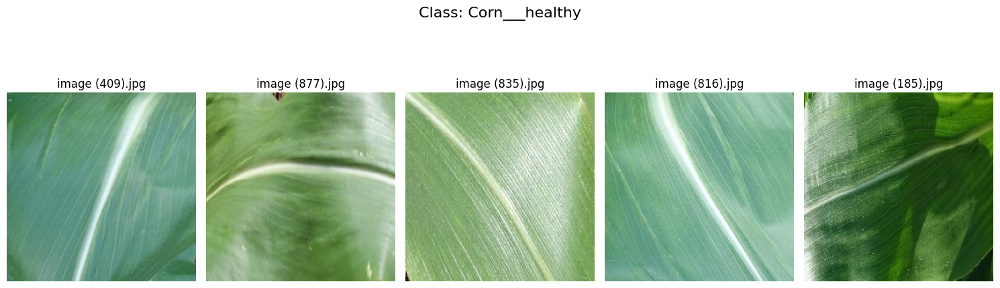

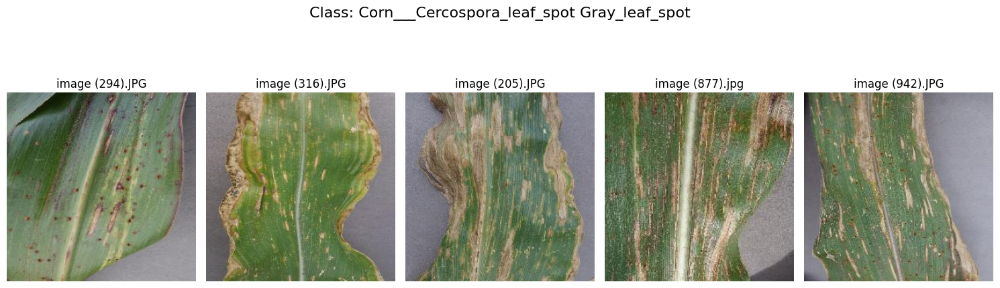

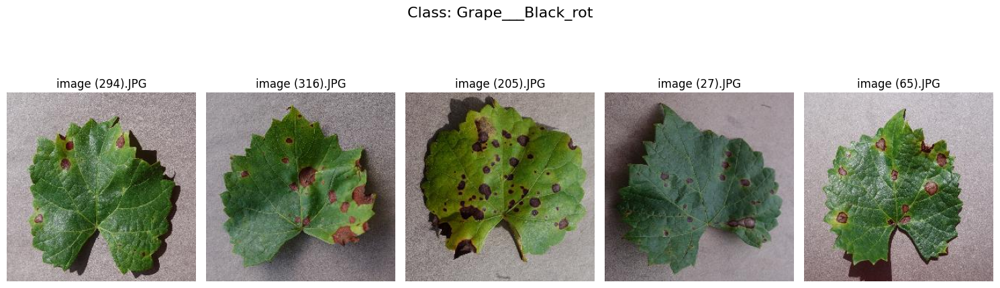

In [ ]:
# Jumlah gambar yang ingin diambil per kelas
num_samples = 5
# Ambil nama kelas
class_folders = os.listdir(dataset_dir)
# Menampilkan gambar dari setiap kelas
for class_name in class_folders:
    class_path = os.path.join(dataset_dir, class_name)
    # Pastikan folder kelas ada
    if os.path.isdir(class_path):
        # Ambil 5 gambar pertama dari kelas tersebut
        sample_images = os.listdir(class_path)[:num_samples]

        # Buat subplots untuk menampilkan gambar secara menyamping
        fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))
        fig.suptitle(f"Class: {class_name}", fontsize=16)

        # Tampilkan gambar di setiap subplot
        for i, img_name in enumerate(sample_images):
            img_path = os.path.join(class_path, img_name)
            img = mpimg.imread(img_path)
            axes[i].imshow(img)
            axes[i].set_title(img_name)
            axes[i].axis('off')  # Menyembunyikan axis

        plt.tight_layout()
        plt.subplots_adjust(top=0.85)  # Memberikan ruang untuk judul utama
        plt.show()

In [ ]:
from PIL import Image
sample_image_path = os.path.join(dataset_dir, class_folders[0], os.listdir(os.path.join(dataset_dir, class_folders[0]))[0])
img = Image.open(sample_image_path)
print(f"Image Size: {img.size}")

Image Size: (256, 256)


In [ ]:
from PIL import Image
import os

# Direktori dataset
dataset_dir = '/content/dataset/Plant_leave_diseases_dataset_with_augmentation'

# Mengambil nama-nama kelas
class_folders = os.listdir(dataset_dir)

# Menyimpan ukuran gambar pertama untuk dibandingkan
first_image_size = None

# Loop melalui setiap kelas dan gambar untuk memeriksa ukurannya
consistent_size = True  # Asumsi awal bahwa ukuran gambar konsisten
sample_count = 0  # Counter untuk jumlah sampel yang sudah dicetak

for class_name in class_folders:
    class_path = os.path.join(dataset_dir, class_name)

    # Pastikan folder kelas ada
    if os.path.isdir(class_path):
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)

            # Pastikan hanya file gambar yang diproses
            if os.path.isfile(img_path):
                # Membuka gambar
                img = Image.open(img_path)

                # Ambil ukuran gambar
                img_size = img.size

                # Jika ini adalah gambar pertama, simpan ukurannya
                if first_image_size is None:
                    first_image_size = img_size
                # Jika ukuran gambar tidak sesuai dengan gambar pertama, beri tanda tidak konsisten
                elif img_size != first_image_size:
                    consistent_size = False
                    # Menampilkan hanya untuk 20 gambar pertama yang ukurannya berbeda
                    if sample_count < 20:
                        print(f"Image {img_name} has a different size: {img_size} (Expected: {first_image_size})")
                        sample_count += 1

# Menampilkan hasil konsistensi ukuran
if consistent_size:
    print("All images have the same size:", first_image_size)
else:
    print("Some images have different sizes.")


Image image (409).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (877).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (835).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (816).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (185).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (1059).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (567).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (621).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (549).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (763).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (999).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (1028).jpg has a different size: (256, 192) (Expected: (256, 256))
Image image (500).jpg has a different size: (256, 192) (Expect

# Data Pre-processing

In [ ]:
import os
import shutil
import random
from sklearn.model_selection import train_test_split

# Tentukan direktori dataset dan direktori tujuan
dataset_dir = '/content/dataset/Plant_leave_diseases_dataset_with_augmentation'
split_dir = '/content/split_dataset'

# Tentukan rasio pembagian
train_ratio = 0.8
val_ratio = 0.1
test_ratio = 0.1

# Buat direktori train, val, dan test
os.makedirs(os.path.join(split_dir, 'train'), exist_ok=True)
os.makedirs(os.path.join(split_dir, 'val'), exist_ok=True)
os.makedirs(os.path.join(split_dir, 'test'), exist_ok=True)

# Ambil daftar nama kelas
class_names = os.listdir(dataset_dir)

# Loop untuk setiap kelas
for class_name in class_names:
    class_path = os.path.join(dataset_dir, class_name)

    if os.path.isdir(class_path):
        # Ambil daftar gambar di setiap kelas
        image_files = os.listdir(class_path)
        # Acak urutan gambar
        random.shuffle(image_files)

        # Hitung jumlah gambar yang akan digunakan untuk train, val, test
        num_images = len(image_files)
        train_end = int(train_ratio * num_images)
        val_end = int((train_ratio + val_ratio) * num_images)

        # Pisahkan gambar untuk masing-masing subset
        train_images = image_files[:train_end]
        val_images = image_files[train_end:val_end]
        test_images = image_files[val_end:]

        # Pastikan folder untuk setiap kelas ada sebelum menyalin gambar
        os.makedirs(os.path.join(split_dir, 'train', class_name), exist_ok=True)
        os.makedirs(os.path.join(split_dir, 'val', class_name), exist_ok=True)
        os.makedirs(os.path.join(split_dir, 'test', class_name), exist_ok=True)

        # Pindahkan gambar ke direktori yang sesuai
        for img in train_images:
            shutil.copy(os.path.join(class_path, img), os.path.join(split_dir, 'train', class_name, img))

        for img in val_images:
            shutil.copy(os.path.join(class_path, img), os.path.join(split_dir, 'val', class_name, img))

        for img in test_images:
            shutil.copy(os.path.join(class_path, img), os.path.join(split_dir, 'test', class_name, img))

# Verifikasi bahwa folder sudah berisi gambar
print("Train Folder:")
print(os.listdir(os.path.join(split_dir, 'train')))
print("Validation Folder:")
print(os.listdir(os.path.join(split_dir, 'val')))
print("Test Folder:")
print(os.listdir(os.path.join(split_dir, 'test')))

Train Folder:
['Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Target_Spot', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Late_blight', 'Background_without_leaves', 'Tomato___healthy', 'Apple___Apple_scab', 'Cherry___healthy', 'Tomato___Tomato_mosaic_virus', 'Soybean___healthy', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Strawberry___Leaf_scorch', 'Pepper,_bell___healthy', 'Tomato___Bacterial_spot', 'Grape___Esca_(Black_Measles)', 'Peach___healthy', 'Cherry___Powdery_mildew', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Squash___Powdery_mildew', 'Corn___Common_rust', 'Strawberry___healthy', 'Tomato___Early_blight', 'Potato___Early_blight', 'Raspberry___healthy', 'Potato___Late_blight', 'Grape___healthy', 'Pepper,_bell___Bacterial_spot', 'Tomato___Septoria_leaf_spot', 'Potato___healthy', 'Apple___healthy', 'Peach___Bacterial_spot', 'Corn___Northern_Leaf_Blight', 'Apple___Cedar_apple_rust', 'Apple___Black_rot', 'Blueberry___healthy', 'Tomato___Leaf_Mold', 'Corn___he

In [ ]:
# Fungsi untuk menghitung jumlah gambar dalam setiap kelas
def count_images_in_folder(folder_path):
    total_images = 0
    # Menelusuri setiap kelas di dalam folder
    for class_folder in os.listdir(folder_path):
        class_folder_path = os.path.join(folder_path, class_folder)
        if os.path.isdir(class_folder_path):  # Jika folder ini adalah kelas
            total_images += len(os.listdir(class_folder_path))  # Menambahkan jumlah gambar
    return total_images

# Tentukan path ke folder train, val, dan test
train_dir = '/content/split_dataset/train'
val_dir = '/content/split_dataset/val'
test_dir = '/content/split_dataset/test'

# Menghitung jumlah gambar di masing-masing folder
train_images = count_images_in_folder(train_dir)
val_images = count_images_in_folder(val_dir)
test_images = count_images_in_folder(test_dir)

# Menampilkan hasilnya
print(f"Jumlah gambar di folder 'train': {train_images}")
print(f"Jumlah gambar di folder 'val': {val_images}")
print(f"Jumlah gambar di folder 'test': {test_images}")


Jumlah gambar di folder 'train': 58941
Jumlah gambar di folder 'val': 11665
Jumlah gambar di folder 'test': 11655


In [ ]:
# Tentukan ukuran gambar
IMAGE_SIZE = (256, 256)
# Membaca dataset dengan image_dataset_from_directory
train_dataset = image_dataset_from_directory(
    os.path.join(split_dir, 'train'),
    image_size=(256, 256),
    batch_size=32,
    shuffle=True,
    seed=123
)

val_dataset = image_dataset_from_directory(
    os.path.join(split_dir, 'val'),
    image_size=(256, 256),
    batch_size=32,
    shuffle=True,
    seed=123
)

test_dataset = image_dataset_from_directory(
    os.path.join(split_dir, 'test'),
    image_size=(256, 256),
    batch_size=32,
    shuffle=False  # Test dataset tidak perlu di-shuffle
)

# Fungsi format_image untuk resize dan normalisasi
def format_image(image, label):
    image = tf.image.resize(image, IMAGE_SIZE) / 255.0  # Resize dan normalisasi
    return image, label

# Terapkan format_image pada train, val, dan test dataset
train_dataset = train_dataset.map(format_image)
val_dataset = val_dataset.map(format_image)
test_dataset = test_dataset.map(format_image)


Found 58941 files belonging to 39 classes.
Found 11665 files belonging to 39 classes.
Found 11655 files belonging to 39 classes.


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models

model = models.Sequential([
    layers.InputLayer(input_shape=(256, 256, 3)),
    # Convolutional layers
    layers.Conv2D(32, (3, 3), activation='relu'),  # Convolutional layer pertama
    layers.MaxPooling2D((2, 2)),  # MaxPooling layer pertama
    layers.Conv2D(64, (3, 3), activation='relu'),  # Convolutional layer kedua
    layers.MaxPooling2D((2, 2)),  # MaxPooling layer kedua
    layers.Conv2D(128, (3, 3), activation='relu'),  # Convolutional layer ketiga
    layers.MaxPooling2D((2, 2)),  # MaxPooling layer ketiga
    layers.Flatten(),  # Flatten layer untuk mengubah hasil 2D menjadi 1D
    layers.Dense(128, activation='relu'),  # Fully connected layer
    layers.Dropout(0.2),  # Dropout layer untuk regularization
    layers.Dense(39, activation='softmax')  # Output layer dengan 39 kelas
])

# Menampilkan summary model
model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/input_layer.py:26: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 254, 254, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 127, 127, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 125, 125, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 62, 62, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 60, 60, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 30, 30, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 115200)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │      14,745,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 39)                  │           5,031 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,844,007 (56.63 MB)

 Trainable params: 14,844,007 (56.63 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile model
model.compile(
    optimizer='adam',  # Optimizer yang digunakan
    loss='sparse_categorical_crossentropy',  # Loss function untuk klasifikasi multi kelas
    metrics=['accuracy']  # Metrics untuk evaluasi model
)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

# Menggunakan early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

In [ ]:
# Melatih model dengan batch size
history = model.fit(
    train_dataset,  # Dataset pelatihan
    epochs=30,  # Jumlah epoch pelatihan
    validation_data=val_dataset,  # Dataset validasi
    batch_size=32,  # Menambahkan batch_size
    callbacks=[early_stopping],  # Gunakan callback early stopping kustom
    verbose=1  # Menampilkan progres pelatihan
)

Epoch 1/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 50s 24ms/step - accuracy: 0.4998 - loss: 1.8352 - val_accuracy: 0.8514 - val_loss: 0.4953
Epoch 2/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.8057 - loss: 0.6161 - val_accuracy: 0.9099 - val_loss: 0.2999
Epoch 3/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.8662 - loss: 0.4141 - val_accuracy: 0.9464 - val_loss: 0.1752
Epoch 4/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.9039 - loss: 0.2920 - val_accuracy: 0.9462 - val_loss: 0.1712
Epoch 5/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.9229 - loss: 0.2342 - val_accuracy: 0.9674 - val_loss: 0.1086
Epoch 6/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.9406 - loss: 0.1817 - val_accuracy: 0.9750 - val_loss: 0.0901
Epoch 7/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.9500 - loss: 0.1535 - val_accuracy: 0.9757 - val_loss: 0.0952
Epoch 8/30
1842/1842 ━━━━━━━━━━━━━━━━━━━━ 35s 19ms/step - accuracy: 0.9576 -

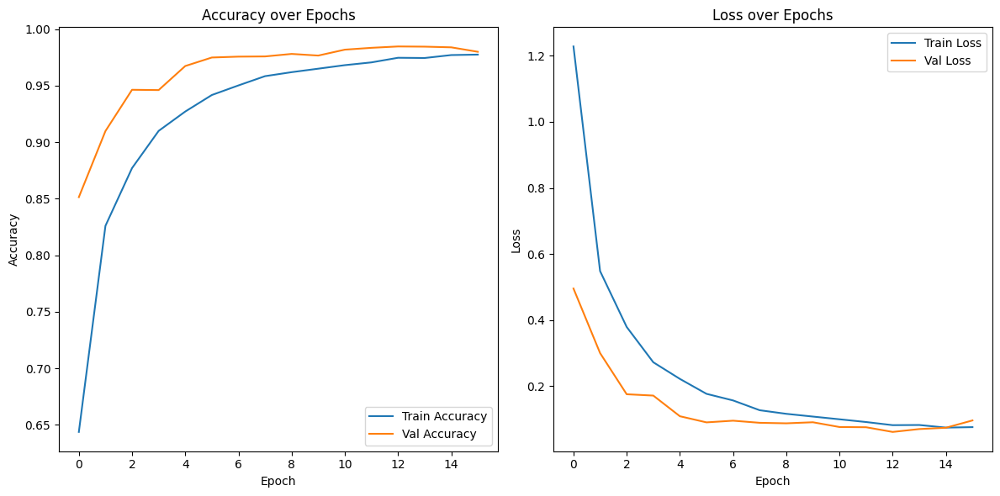

In [ ]:
# Grafik untuk visualisasi akurasi dan loss pada train dan validation

# Plot Akurasi
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Val Accuracy')
plt.title('Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Loss over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

# Menampilkan grafik
plt.tight_layout()
plt.show()

In [ ]:
# Evaluasi model pada data testing
test_loss, test_accuracy = model.evaluate(test_dataset)
print(f"Test accuracy: {test_accuracy}")

365/365 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9848 - loss: 0.0687
Test accuracy: 0.9854997992515564


In [ ]:
# import matplotlib.pyplot as plt
# import tensorflow as tf
# import numpy as np

# # Menyebutkan nama kelas yang ada pada dataset
# class_names = [
#     "Tomato___Tomato_Yellow_Leaf_Curl_Virus",
#     "Tomato___Target_Spot",
#     "Orange___Haunglongbing_(Citrus_greening)",
#     "Tomato___Late_blight",
#     "Background_without_leaves",
#     "Tomato___healthy",
#     "Apple___Apple_scab",
#     "Cherry___healthy",
#     "Tomato___Tomato_mosaic_virus",
#     "Soybean___healthy",
#     "Tomato___Spider_mites Two-spotted_spider_mite",
#     "Strawberry___Leaf_scorch",
#     "Pepper,_bell___healthy",
#     "Tomato___Bacterial_spot",
#     "Grape___Esca_(Black_Measles)",
#     "Peach___healthy",
#     "Cherry___Powdery_mildew",
#     "Grape___Leaf_blight_(Isariopsis_Leaf_Spot)",
#     "Squash___Powdery_mildew",
#     "Corn___Common_rust",
#     "Strawberry___healthy",
#     "Tomato___Early_blight",
#     "Potato___Early_blight",
#     "Raspberry___healthy",
#     "Potato___Late_blight",
#     "Grape___healthy",
#     "Pepper,_bell___Bacterial_spot",
#     "Tomato___Septoria_leaf_spot",
#     "Potato___healthy",
#     "Apple___healthy",
#     "Peach___Bacterial_spot",
#     "Corn___Northern_Leaf_Blight",
#     "Apple___Cedar_apple_rust",
#     "Apple___Black_rot",
#     "Blueberry___healthy",
#     "Tomato___Leaf_Mold",
#     "Corn___healthy",
#     "Corn___Cercospora_leaf_spot Gray_leaf_spot",
#     "Grape___Black_rot"
# ]

# # Fungsi untuk menampilkan gambar, nama penyakit, dan hasil prediksi
# def display_images_with_predictions(model, dataset, num_images=50, batch_size=10):
#     # Total gambar yang ingin ditampilkan
#     count = 0
#     fig, axes = plt.subplots(5, 2, figsize=(10, 25))  # 5 baris dan 2 kolom untuk menampilkan gambar

#     # Iterasi melalui dataset
#     for images, labels in dataset.take(num_images // batch_size):
#         # Prediksi model
#         predictions = model.predict(images)

#         # Debug print untuk memeriksa bentuk output
#         print(f"Predictions shape: {predictions.shape}")

#         # Ambil indeks kelas dengan probabilitas tertinggi
#         predicted_classes = np.argmax(predictions, axis=1)  # Ambil indeks kelas dengan probabilitas tertinggi
#         true_classes = np.argmax(labels, axis=1)  # Ambil kelas yang benar dari labels

#         # Tampilkan gambar per batch
#         for i in range(batch_size):
#             if count >= num_images:
#                 break

#             # Ambil gambar dan label
#             image = images[i].numpy()  # Convert tensor to numpy array for imshow
#             true_class = true_classes[i]
#             predicted_class = predicted_classes[i]

#             # Buat subplot untuk gambar
#             ax = axes[count // 10, count % 2]
#             ax.imshow(image)
#             ax.axis('off')  # Hapus axis untuk gambar

#             # Cek apakah prediksi benar
#             if predicted_class == true_class:
#                 color = 'green'
#             else:
#                 color = 'red'

#             # Tampilkan teks di bawah gambar
#             ax.set_title(f'Pred: {class_names[predicted_class]}\nTrue: {class_names[true_class]}',
#                          fontsize=10, color=color)

#             count += 1

#     plt.tight_layout()
#     plt.show()

# # Gunakan fungsi display_images_with_predictions
# display_images_with_predictions(model, test_dataset, num_images=50, batch_size=10)


In [ ]:
import os

# Membuat direktori jika belum ada
os.makedirs('/content/saved_model', exist_ok=True)
# Menyimpan model dalam format .keras
model.save('/content/saved_model/my_model.keras')


In [ ]:

from google.colab import files
import shutil

# Membuat file ZIP untuk model
shutil.make_archive('my_model', 'zip', '/content/saved_model/my_model')

# Unduh file ZIP
files.download('my_model.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Salin model ke Google Drive
!cp -r /content/saved_model/my_model /content/drive/MyDrive/


cp: cannot stat '/content/saved_model/my_model': No such file or directory


In [ ]:
!pip list

Package                            Version
---------------------------------- --------------------
absl-py                            1.4.0
accelerate                         1.1.1
aiohappyeyeballs                   2.4.3
aiohttp                            3.10.10
aiosignal                          1.3.1
alabaster                          1.0.0
albucore                           0.0.19
albumentations                     1.4.20
altair                             4.2.2
annotated-types                    0.7.0
anyio                              3.7.1
argon2-cffi                        23.1.0
argon2-cffi-bindings               21.2.0
array_record                       0.5.1
arviz                              0.20.0
astropy                            6.1.6
astropy-iers-data                  0.2024.11.11.0.32.38
astunparse                         1.6.3
async-timeout                      4.0.3
atpublic                           4.1.0
attrs                              24.2.0
audioread        